Сравнительный анализ вакансий для Аналитиков данных и Системных анаитиков.

#**Цель проекта**
Целью проекта является, выявление различий в предлагаемых вакасиях для Аналитика данных и Системных аналитиков.

В распоряжении у нас две таблицы:

vacancies_sa.xlsc - вакансии Системного аналитика

vacancies_da(1).xlsc - вакансии Аналитика данных

Ссылка для скачивания: https://disk.yandex.ru/d/eA4zuI8qPag-KQ

Задачи проекта:
- Выявление грейда требуемых специалистов;
- Определение доли грейдов Junior, Junior+, Middle, Senior среди вакансий Аналитик данных и Системный аналитик;
- Определение типичного места работы для Аналитика данных и Системного аналитика, по определенным параметрам: ТОП-работодателей, заработная плата, тип занятости, график работы;
- Определение наиболее желаемых кандидатов по таким параметрам как "hard skills" и "soft skills", в том числе для каждого грейда по отдельности.
- Расчет помесячной динамики количества вакансий для Аналитика данных и системного аналитика



#**Ход исследования:**

**1. Выгрузка данных**

**2. Предобработка данных**

Проверить типы данных. Проверить наличие дубликатов в таблицах. Изучить пропуски в датафрейме.

**3. Исследовательский анализ данных**

**4. Определить грейд требуемых специалистов**

**5. Определить долю грейдов Junior, Junior+, Middle, Senior среди вакансий Аналитик данных и Системных аналитков**

**6. Найти типичное место работы для Аналитика данных и для Системны аналитков**

**7. Расчет помесячной динамики количества вакансий**

**8. ОБЩИЙ ВЫВОД**


**Описание данных:**

**id** - Уникальный идентификатор вакансии.

**name** - Название вакансии.

**published_at** - Дата публикации.

**alternate_url** - Ссылка на вакансию.

**type** - Статус вакансии на момент получения данных от api и передачи
их в базу.

**employer** - Работодатель.

**department** - Работодатель, отдел.

**area** - Регион места работы.

**experience** - Требуемый опыт работы.

**key_skills** - Ключевые навыки, в том числе найденные при анализе
полного текста вакансии. Поле генерируется после получения
информации от api.

**schedule** - График работы.

**employment** - Тип занятости.

**description** - Описание вакансии.

**description_lemmatized** - Лемматизированное описание вакансии.

**salary_from** - Нижняя граница предлагаемой заработной платы.

**salary_to** - Верхняя граница предлагаемой заработной платы.

**salary_bin** - Категория зарплаты.

**key_skills_from_key_skills_field** - Ключевые навыки из поля вакансии
key_skills.

**hard_skills_from_description** - “Твердые” навыки, найденные при
обработке полей с навыками. Поле генерируется после получения
информации от api.

**soft_skills_from_description** - “Мягкие” навыки,
найденные при обработке полей с навыками. Поле генерируется после
получения информации от api.

**1. Выгрузка данных, импорт библиотек**




In [69]:
import pandas as pd # Импортируем библиотеку pandas для работы с таблицами данных
from google.colab import files
!pip install pd # Импортируем библиотеку для загрузки файлов
import numpy as np # Импортируем библиотеку numpy для работы с числовыми массивами
from datetime import datetime, timedelta # Импортируем библиотеку для работы с датой и временем
from matplotlib import pyplot as plt # Импортируем библиотеку matplotlib для построения графиков
import seaborn as sns # Импортируем библиотеку seaborn для создания статистических графиков
import plotly.express as px # Импортируем библиотеку для работы с графиками на основе данных из датафрейма

In [70]:
uploaded = files.upload()

Saving vacancies_da (1).xlsx to vacancies_da (1) (1).xlsx
Saving vacancies_sa.xlsx to vacancies_sa (1).xlsx


In [71]:
for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

User uploaded file "vacancies_da (1) (1).xlsx" with length 2866240 bytes
User uploaded file "vacancies_sa (1).xlsx" with length 3869512 bytes


In [72]:
uploaded

{'vacancies_da (1) (1).xlsx': b'PK\x03\x04\x14\x00\x06\x00\x08\x00\x00\x00!\x00b\xee\x9dh^\x01\x00\x00\x90\x04\x00\x00\x13\x00\x08\x02[Content_Types].xml \xa2\x04\x02(\xa0\x00\x02\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\

In [73]:
data_da = pd.read_excel('/content/vacancies_da (1).xlsx')
data_sa = pd.read_excel('/content/vacancies_sa.xlsx')
# Читаем данные из Excel файлов  'vacancies_da(1).xlsx' и 'vacancies_sa.xlsx'

In [74]:
def display_and_info(df):
    display(df.head())
    print('-----------')
    print(df.info())

display_and_info(data_da)
# Посмотреть основную информацию и первые 5 строк

,id,name,published_at,alternate_url,type,employer,department,area,experience,key_skills,schedule,employment,description,description_lemmatized,salary_from,salary_to,salary_bin,key_skills_from_key_skills_field,hard_skills_from_description,soft_skills_from_description
0,100039284,Junior аналитик данных (исследователь),2024-05-24 09:37:04,https://hh.ru/vacancy/100039284,Открытая,DNS Головной офис,NaN,Владивосток,Junior (no experince),"['Power BI', 'СУБД', 'Python', 'SQL']",Полный день,Полная занятость,наше направление занимается повышением эффекти...,наш направление заниматься повышение эффективн...,60000.0,NaN,ЗП не указана,"SQL, Power BI, Python, СУБД",NaN,NaN
1,100039480,Аналитик данных,2024-05-24 09:39:00,https://hh.ru/vacancy/100039480,Открытая,Комус,NaN,Москва,Junior (no experince),"['MS SQL', 'Работа с базами данных', 'MS Excel']",Полный день,Полная занятость,сегодня комус один из крупнейших поставщиков о...,сегодня комус крупный поставщик офисный товар ...,NaN,NaN,ЗП не указана,"Работа с базами данных, MS SQL, MS Excel",NaN,NaN
2,100042705,Аналитик данных (исследователь),2024-05-24 10:01:25,https://hh.ru/vacancy/100042705,Открытая,DNS Головной офис,NaN,Владивосток,Junior+ (1-3 years),"['SQL', 'Power BI', 'СУБД', 'Python', 'Clickho...",Полный день,Полная занятость,наше направление занимается повышением эффекти...,наш направление заниматься повышение эффективн...,90000.0,NaN,ЗП не указана,"SQL, Power BI, Python, СУБД, BPMN, Clickhouse",NaN,NaN
3,100046788,Ведущий аналитик данных,2024-05-24 10:28:18,https://hh.ru/vacancy/100046788,Открытая,Х5 Group,"X5 GROUP, Центральный офис",Москва,Junior+ (1-3 years),"['Анализ данных', 'Коммуникация', 'SQL', 'MS O...",Полный день,Полная занятость,задачи: разработка бизнес-моделей для группов...,задача разработка бизнес модель групповой прог...,NaN,NaN,ЗП не указана,"MS Office, SQL, Python, Hadoop, Нive, Аналитич...","Pandas, Юнит-экономика",Коммуникация
4,100056244,Аналитик данных,2024-05-24 11:27:40,https://hh.ru/vacancy/100056244,Открытая,ЛУКОЙЛ,NaN,Москва,Middle (3-6 years),['Документация'],Полный день,Полная занятость,"обязанности: участие в проектировании, разраб...",обязанность участие проектирование разработка ...,NaN,NaN,ЗП не указана,NaN,NaN,Документация


-----------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1801 entries, 0 to 1800
Data columns (total 20 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   id                                1801 non-null   int64         
 1   name                              1801 non-null   object        
 2   published_at                      1801 non-null   datetime64[ns]
 3   alternate_url                     1801 non-null   object        
 4   type                              1801 non-null   object        
 5   employer                          1801 non-null   object        
 6   department                        521 non-null    object        
 7   area                              1801 non-null   object        
 8   experience                        1801 non-null   object        
 9   key_skills                        1801 non-null   object        
 10  schedule                          18

In [75]:
def display_and_info(df):
    display(df.head())
    print('-----------')
    print(df.info())

display_and_info(data_sa)
# Посмотреть основную информацию и первые 5 строк

,id,name,published_at,alternate_url,type,employer,department,area,experience,key_skills,schedule,employment,description,description_lemmatized,salary_from,salary_to,salary_bin,key_skills_from_key_skills_field,hard_skills_from_description,soft_skills_from_description
0,100046399,Системный аналитик,2024-07-08 10:22:57,https://hh.ru/vacancy/100046399,Открытая,Юрент,NaN,Москва,Middle (3-6 years),"['1С', 'Аналитический склад ума', 'confluence'...",Полный день,Полная занятость,юрент — это новый уровень городской мобильност...,юрент новый уровень городской мобильность круп...,NaN,NaN,ЗП не указана,"SQL, Аналитический склад ума, 1С",confluence,NaN
1,100050107,Бизнес/Системный Аналитик,2024-07-06 17:19:32,https://hh.ru/vacancy/100050107,Открытая,Surf,NaN,Санкт-Петербург,Junior+ (1-3 years),"['Разработка технических заданий', 'Бизнес-ана...",Удаленная работа,Полная занятость,в surf уже 13 лет мы разрабатываем много разны...,surf 13 год разрабатывать разный продукт начин...,NaN,NaN,ЗП не указана,"BPMN, UML, Английский язык, Системный анализ, ...",NaN,Документация
2,100059559,Системный IT аналитик,2024-07-08 11:48:17,https://hh.ru/vacancy/100059559,Открытая,AMarkets,NaN,Москва,Junior+ (1-3 years),['Документация'],Полный день,Полная занятость,"мы - международная fintech компания amarkets, ...",международный fintech компания amarkets 2 7 го...,233750.0,NaN,ЗП не указана,NaN,NaN,Документация
3,100063260,Системный Аналитик ERP-решений,2024-07-09 10:51:54,https://hh.ru/vacancy/100063260,Открытая,Астор,NaN,Москва,Senior (6+ years),"['ERP', 'Atlassian Jira', '1С: Управление Прои...",Удаленная работа,Полная занятость,компания «астор» с 2000 года занимается разраб...,компания астор 2 год заниматься разработка вне...,NaN,NaN,ЗП не указана,"ERP, 1С: Управление Торговлей, Atlassian Jira,...",confluence,Коммуникация
4,100064793,Системный аналитик,2024-07-08 16:39:40,https://hh.ru/vacancy/100064793,Открытая,Зетта Страхование,NaN,Москва,Junior+ (1-3 years),"['JSON', 'SQL', 'XML', 'SOAP', 'HTML', 'JS', '...",Полный день,Полная занятость,обязанности: анализ задач развития и сопрово...,обязанность анализ задача развитие сопровожден...,NaN,NaN,ЗП не указана,"SQL, C#, Java, JS, SOAP, JSON, XML, HTML, CSS",NaN,NaN


-----------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1915 entries, 0 to 1914
Data columns (total 20 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   id                                1915 non-null   int64         
 1   name                              1915 non-null   object        
 2   published_at                      1915 non-null   datetime64[ns]
 3   alternate_url                     1915 non-null   object        
 4   type                              1915 non-null   object        
 5   employer                          1915 non-null   object        
 6   department                        361 non-null    object        
 7   area                              1915 non-null   object        
 8   experience                        1915 non-null   object        
 9   key_skills                        1915 non-null   object        
 10  schedule                          19

Обе таблицы содержат одинаковые столбцы подразумевающие одинаковые типы данных и различаются только видом вакансий.  Кличество вакансий аналитиков данных и системных аналитиков примерно одинаковое.


# **Предобработка данных**

**Проверим типы данных**

Проверим типы данных в датафрейме и преобразуем их там, где это необходимо.
При рассмотрении типов данных можно увидеть, что в столбце salary_bin тип данных object, хотя в других столбцах значения зарплаты имеют формат float64, для понимания необходимо вывести уникальные значения данного столбца.

In [76]:
value_list = list(set(data_da['salary_bin'].unique()))
sorted(value_list)

# Просмотр уникальных значений столбца salary_bin датафрейма da

['Больше 300 тысяч',
 'ЗП не указана',
 'Меньше 100 тысяч',
 'От 100 тысяч до 200 тысяч',
 'От 200 тысяч до 300 тысяч']

In [77]:
value_list = list(set(data_sa['salary_bin'].unique()))
sorted(value_list)

# Просмотр уникальных значений столбца salary_bin датафрейма sa

['Больше 300 тысяч',
 'ЗП не указана',
 'Меньше 100 тысяч',
 'От 100 тысяч до 200 тысяч',
 'От 200 тысяч до 300 тысяч']

В данном столбце зарплаты разделены на 4 категории, одна из них "ЗП не указана", остальны категории с диапазонами значений, исходя из этого тип данных менять не имеет смысла. Остальные столбцы соответствуют типа представленных данных.

Поскольку типы данных совпадают с представленными значениями, совпадает количествj столбцов и содержание двух таблиц, то мы можем их объеденить, но для дальнейшего анализа нужно выделить признак вида вакансии,  и добавить столбец type_vacancy: **data_analityc - Аналитик данных**, **sistem_analityc - Системный аналитик**.

In [78]:
data_da['vacansy_type']='data_analityc'
# Добавили столбец с признаком вакансии

In [79]:
data_sa['vacansy_type']='sistem_analityc'
# Добавили столбец с признаком вакансии

In [12]:
for df in [data_da, data_sa]:
    if df.duplicated().sum() > 0:
        df.duplicated().sum()
    else:
        print(f'В таблице дубликатов нет')
# Проверим наличие дубликатов в таблице

В таблице дубликатов нет
В таблице дубликатов нет


In [80]:
all_vacanсy = pd.concat([data_da, data_sa])
# Объеденим две таблицы

In [82]:
all_vacanсy['vacansy_type'].value_counts()
# Проверим количество строк вошедших в объедененный датасет

vacansy_type
sistem_analityc    1915
data_analityc      1801
Name: count, dtype: int64

In [83]:
def display_and_info(all_vacancy):
    display(df.head())
    print('-----------')
    print(df.info())

display_and_info(all_vacanсy)
# Посмотреть основную информацию и первые 5 строк

,id,name,published_at,alternate_url,type,employer,department,area,experience,key_skills,...,salary_bin,key_skills_from_key_skills_field,hard_skills_from_description,soft_skills_from_description,vacansy_type,hard_skills,soft_skills,avg_salary,data_analytics,system_analytics
0,100039284,Junior аналитик данных (исследователь),2024-05-24 09:37:04,https://hh.ru/vacancy/100039284,Открытая,DNS Головной офис,NaN,Владивосток,Junior (no experince),"['Power BI', 'СУБД', 'Python', 'SQL']",...,ЗП не указана,"SQL, Power BI, Python, СУБД",NaN,NaN,data_analityc,"[['power bi', 'субд', 'python', 'sql']]","[['power bi', 'субд', 'python', 'sql']]",60000.0,2024-02-13 21:45:51,2024-02-13 21:45:51
1,100039480,Аналитик данных,2024-05-24 09:39:00,https://hh.ru/vacancy/100039480,Открытая,Комус,NaN,Москва,Junior (no experince),"['MS SQL', 'Работа с базами данных', 'MS Excel']",...,ЗП не указана,"Работа с базами данных, MS SQL, MS Excel",NaN,NaN,data_analityc,"[['ms sql', 'работа с базами данных', 'ms exce...","[['ms sql', 'работа с базами данных', 'ms exce...",NaN,2024-02-13 21:45:51,2024-02-13 21:45:51
2,100042705,Аналитик данных (исследователь),2024-05-24 10:01:25,https://hh.ru/vacancy/100042705,Открытая,DNS Головной офис,NaN,Владивосток,Junior+ (1-3 years),"['SQL', 'Power BI', 'СУБД', 'Python', 'Clickho...",...,ЗП не указана,"SQL, Power BI, Python, СУБД, BPMN, Clickhouse",NaN,NaN,data_analityc,"[['sql', 'power bi', 'субд', 'python', 'clickh...","[['sql', 'power bi', 'субд', 'python', 'clickh...",90000.0,2024-02-13 21:45:51,2024-02-13 21:45:51
4,100056244,Аналитик данных,2024-05-24 11:27:40,https://hh.ru/vacancy/100056244,Открытая,ЛУКОЙЛ,NaN,Москва,Middle (3-6 years),['Документация'],...,ЗП не указана,NaN,NaN,Документация,data_analityc,[['документация']],[['документация']],NaN,2024-02-13 21:45:51,2024-02-13 21:45:51
5,100059110,Senior Data Analyst (Цифровой билайн),2024-06-11 11:45:29,https://hh.ru/vacancy/100059110,Открытая,билайн,"билайн: ИТ, Data, Digital",Москва,Middle (3-6 years),"['Python', 'SQL', 'Математическая статистика']",...,ЗП не указана,"Python, SQL, Математическая статистика",NaN,NaN,data_analityc,"[['python', 'sql', 'математическая статистика']]","[['python', 'sql', 'математическая статистика']]",NaN,2024-02-13 21:45:51,2024-02-13 21:45:51


-----------
<class 'pandas.core.frame.DataFrame'>
Index: 3494 entries, 0 to 1914
Data columns (total 26 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   id                                3494 non-null   int64         
 1   name                              3494 non-null   object        
 2   published_at                      3494 non-null   datetime64[ns]
 3   alternate_url                     3494 non-null   object        
 4   type                              3494 non-null   object        
 5   employer                          3494 non-null   object        
 6   department                        795 non-null    object        
 7   area                              3494 non-null   object        
 8   experience                        3494 non-null   object        
 9   key_skills                        3494 non-null   object        
 10  schedule                          3494 no

В таблицах отсутствуют явные дубликаты, после объеденения количество строк сохранено.

In [84]:
len(all_vacanсy[all_vacanсy.duplicated(
    ['name','type','employer','department','area','experience','key_skills',
     'schedule','employment','description','description_lemmatized','salary_from','salary_from','salary_bin',
     'key_skills_from_key_skills_field','hard_skills_from_description','soft_skills_from_description'])])
# Посмотрим количество неявных дубликатов

217

In [85]:
all_vacanсy[all_vacanсy.duplicated(
    subset=['name', 'type', 'employer', 'department',
            'area', 'experience', 'key_skills', 'schedule',
            'employment', 'description', 'salary_bin', 'vacansy_type'],
    keep=False
    )].sort_values(by=['name', 'employer', 'area', 'experience','key_skills', 'published_at'])


,id,name,published_at,alternate_url,type,employer,department,area,experience,key_skills,...,employment,description,description_lemmatized,salary_from,salary_to,salary_bin,key_skills_from_key_skills_field,hard_skills_from_description,soft_skills_from_description,vacansy_type
1408,98088004,BI-аналитик/ Аналитик данных,2024-05-12 17:09:30,https://hh.ru/vacancy/98088004,Открытая,Сэлвим,NaN,Москва,Junior+ (1-3 years),['Pandas'],...,Полная занятость,обязанности: сбор бизнес-требований от внутре...,обязанность сбор бизнес требование внутренний ...,NaN,NaN,ЗП не указана,NaN,Pandas,NaN,data_analityc
72,100463980,BI-аналитик/ Аналитик данных,2024-06-09 10:00:29,https://hh.ru/vacancy/100463980,Открытая,Сэлвим,NaN,Москва,Junior+ (1-3 years),['Pandas'],...,Полная занятость,обязанности: сбор бизнес-требований от внутре...,обязанность сбор бизнес требование внутренний ...,NaN,NaN,ЗП не указана,NaN,Pandas,NaN,data_analityc
631,94702965,Data Analyst,2024-03-13 16:57:00,https://hh.ru/vacancy/94702965,Открытая,СБЕР,Сбер. Data Science,Москва,Junior+ (1-3 years),['Pandas'],...,Полная занятость,наша команда занимается разработкой и внедрени...,наш команда заниматься разработка внедрение ml...,NaN,NaN,ЗП не указана,NaN,Pandas,NaN,data_analityc
1345,97831652,Data Analyst,2024-04-24 16:47:53,https://hh.ru/vacancy/97831652,Открытая,СБЕР,Сбер. Data Science,Москва,Junior+ (1-3 years),['Pandas'],...,Полная занятость,наша команда занимается разработкой и внедрени...,наш команда заниматься разработка внедрение ml...,NaN,NaN,ЗП не указана,NaN,Pandas,NaN,data_analityc
528,93826192,Data Analyst,2024-03-27 16:29:20,https://hh.ru/vacancy/93826192,Открытая,СБЕР,Сбер. Data Science,Москва,Junior+ (1-3 years),['Документация'],...,Полная занятость,в настоящее время сбербанк активно развивает н...,настоящий время сбербанк активно развивать нап...,NaN,NaN,ЗП не указана,NaN,NaN,Документация,data_analityc
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1030,96494928,Старший аналитик данных (маркетинг),2024-04-09 09:38:57,https://hh.ru/vacancy/96494928,Открытая,Ozon,Ozon Офис и Коммерция,Москва,Middle (3-6 years),"['SQL', 'Python', 'Маркетинг, реклама, PR', 'М...",...,Полная занятость,чем предстоит заниматься: отслеживать и собир...,предстоять заниматься отслеживать собирать раз...,NaN,NaN,ЗП не указана,"Маркетинг, реклама, PR, аналитика данных, Pyth...",Pandas,NaN,data_analityc
819,95548988,Урбан-аналитик данных,2024-03-26 15:33:29,https://hh.ru/vacancy/95548988,Открытая,Mayak,NaN,Москва,Junior+ (1-3 years),"['Английский язык', 'Анализ данных', 'Девелопм...",...,Частичная занятость,обязанности: • анализ рынка/субрынков коммерче...,обязанность анализ рынок субрынок коммерческий...,100000.0,NaN,ЗП не указана,"Маркетинговый анализ, Английский язык, GIS, Та...",NaN,Тайм-менеджмент,data_analityc
1747,99737480,Урбан-аналитик данных,2024-06-08 17:13:09,https://hh.ru/vacancy/99737480,Открытая,Mayak,NaN,Москва,Junior+ (1-3 years),"['Английский язык', 'Анализ данных', 'Девелопм...",...,Частичная занятость,обязанности: • анализ рынка/субрынков коммерче...,обязанность анализ рынок субрынок коммерческий...,100000.0,NaN,ЗП не указана,"Маркетинговый анализ, Английский язык, GIS, Та...",NaN,Тайм-менеджмент,data_analityc
1302,97652565,Эксперт-аналитик данных в группу цифрового аудита,2024-04-22 18:24:19,https://hh.ru/vacancy/97652565,Открытая,Recruitment Boutique S.M.Art,NaN,Москва,Junior+ (1-3 years),"['Аудит', 'Python', 'MS SQL']",...,Полная занятость,ищем эксперта со знанием инструментов анализа ...,искать эксперт знание инструмент анализ данные...,NaN,NaN,ЗП не указана,"Аудит, MS SQL, Python",NaN,NaN,data_analityc


In [86]:
all_after_drop = all_vacanсy.shape[0]
# Зафиксируем количество строк до удаления дублей

In [87]:
all_vacanсy = all_vacanсy.drop_duplicates(
              subset=['name', 'type', 'employer', 'department',
                      'area', 'experience', 'key_skills', 'schedule',
                      'employment', 'description', 'salary_bin', 'vacansy_type'],
              keep='last'
              )
# Удаляем первую стройчку дубликата

In [88]:

print(f'Удалили {(all_after_drop - all_vacanсy.shape[0]) / all_after_drop:.2%} данных')
# Проверим какой процент данных мы удалили

Удалили 5.97% данных


После удаления дубликатов осталось ~ 95% данных, с которыми будем работать далее.

In [89]:
all_vacanсy.duplicated(subset='id').sum()
# Количество дубикатов по id

5

In [90]:
id_duplicated= all_vacanсy[all_vacanсy.duplicated(subset='id')]['id']
# Список дублирующихся id

In [91]:
all_vacanсy.query('id in @id_duplicated').sort_values(by=['id', 'published_at'])
# Посмотрим на вакансии с одинаковам id

,id,name,published_at,alternate_url,type,employer,department,area,experience,key_skills,...,employment,description,description_lemmatized,salary_from,salary_to,salary_bin,key_skills_from_key_skills_field,hard_skills_from_description,soft_skills_from_description,vacansy_type
344,85053195,System analyst DWH / Data Analyst,2024-06-03 09:36:32,https://hh.ru/vacancy/85053195,Открытая,Axenix (ранее Accenture),NaN,Краснодар,Junior+ (1-3 years),"['Teradata', 'SQL', 'Документация', 'Greenplum...",...,Полная занятость,компания axenix (ранее accenture) продолжает р...,компания axenix ранее accenture продолжать раб...,NaN,NaN,ЗП не указана,"SQL, DWH, Teradata, Hadoop, Airflow, Greenplum...",NaN,Документация,data_analityc
1377,85053195,System analyst DWH,2024-07-01 10:11:06,https://hh.ru/vacancy/85053195,Открытая,Axenix (ранее Accenture),NaN,Краснодар,Junior+ (1-3 years),"['ORACLE', 'Airflow', 'SQL', 'Документация', '...",...,Полная занятость,компания axenix (ранее accenture) продолжает р...,компания axenix ранее accenture продолжать раб...,NaN,NaN,ЗП не указана,"SQL, DWH, Teradata, Hadoop, Airflow, Greenplum...",NaN,Документация,sistem_analityc
1461,98441008,Системный аналитик (DWH)/Аналитик данных (офис...,2024-06-11 09:57:39,https://hh.ru/vacancy/98441008,Открытая,AVO.UZ,NaN,Москва,Junior+ (1-3 years),"['MS SQL', 'Системный анализ', 'DWH']",...,Полная занятость,команда avo services and technology создает по...,команда avo services and technology создавать ...,NaN,NaN,ЗП не указана,"DWH, MS SQL, Системный анализ",NaN,NaN,data_analityc
1758,98441008,Системный аналитик (DWH)/Аналитик данных (офис...,2024-07-08 09:57:40,https://hh.ru/vacancy/98441008,Открытая,AVO.UZ,NaN,Москва,Junior+ (1-3 years),"['DWH', 'MS SQL', 'Системный анализ']",...,Полная занятость,команда avo services and technology создает по...,команда avo services and technology создавать ...,NaN,NaN,ЗП не указана,"DWH, MS SQL, Системный анализ",NaN,NaN,sistem_analityc
102,100581829,Аналитик данных \ Data analyst,2024-05-29 10:27:00,https://hh.ru/vacancy/100581829,Открытая,Сеть Партнерств,NaN,Москва,Middle (3-6 years),"['SQL', 'API', 'Python', 'Документация', 'conf...",...,Полная занятость,мы - аккредитованная продуктовая it-компания.м...,аккредитовать продуктовый it компания создател...,250000.0,NaN,ЗП не указана,"SQL, Python, PostgreSQL, API, ETL, DWH, Базы д...",confluence,Документация,data_analityc
31,100581829,Аналитик данных \ Системный аналитик,2024-06-27 12:04:15,https://hh.ru/vacancy/100581829,Открытая,Сеть Партнерств,NaN,Москва,Middle (3-6 years),"['SQL', 'Python', 'Документация', 'DWH', 'conf...",...,Полная занятость,мы - аккредитованная продуктовая it-компания.м...,аккредитовать продуктовый it компания создател...,250000.0,NaN,ЗП не указана,"SQL, Python, PostgreSQL, API, ETL, DWH, Базы д...",confluence,Документация,sistem_analityc
103,100581830,Аналитик данных \ Data analyst,2024-05-29 10:27:00,https://hh.ru/vacancy/100581830,Открытая,Сеть Партнерств,NaN,Краснодар,Middle (3-6 years),"['confluence', 'Документация']",...,Полная занятость,мы - аккредитованная продуктовая it-компания.м...,аккредитовать продуктовый it компания создател...,250000.0,NaN,ЗП не указана,NaN,confluence,Документация,data_analityc
32,100581830,Системный аналитик \ Аналитик данных,2024-06-27 12:12:35,https://hh.ru/vacancy/100581830,Открытая,Сеть Партнерств,NaN,Краснодар,Middle (3-6 years),"['confluence', 'Документация']",...,Полная занятость,мы - аккредитованная продуктовая it-компания.м...,аккредитовать продуктовый it компания создател...,250000.0,NaN,ЗП не указана,NaN,confluence,Документация,sistem_analityc
104,100581831,Аналитик данных \ Data analyst,2024-05-29 10:27:00,https://hh.ru/vacancy/100581831,Открытая,Сеть Партнерств,NaN,Санкт-Петербург,Middle (3-6 years),"['confluence', 'Документация']",...,Полная занятость,мы - аккредитованная продуктовая it-компания.м...,аккредитовать продуктовый it компания создател...,250000.0,NaN,ЗП не указана,NaN,confluence,Документация,data_analityc
33,10058183

У продублированных вакансий разный тип вакансии, т.о можно предположиь что это один и тот же вид вакансии отнесенный к разным типам вакансии - Дата аналитик или Системный аналитик.

In [92]:
all_vacanсy['name'].nunique()
# Уникальные названия вакансий

1574

In [93]:
all_vacanсy['name'].value_counts().head(10)
#  TOP-10 уникальных названий вакансий

name
Системный аналитик            564
Аналитик данных               409
Data Analyst                   80
Системный аналитик 1С          62
Ведущий системный аналитик     48
Ведущий аналитик данных        27
Системный аналитик DWH         25
Старший системный аналитик     24
Data analyst                   22
System analyst                 22
Name: count, dtype: int64

In [94]:
all_vacanсy['employer'].nunique()
# Посмотрим количество уникальных названий работодателей

1358

In [95]:
all_vacanсy['employer'].value_counts().head(10)
# TOP-10 работодаелей по количеству опубликованных вакансий

employer
СБЕР                         296
Т1                           101
Aston                         66
WILDBERRIES                   42
ПСБ (ПАО «Промсвязьбанк»)     38
Совкомбанк Технологии         37
Ozon                          36
МТС                           35
Банк ВТБ (ПАО)                31
билайн                        26
Name: count, dtype: int64

In [96]:
all_vacanсy['area'].nunique()
# Посмотрим уникальное количество городов с опубликованными вакансиями

106

In [97]:
all_vacanсy['area'].value_counts().head(10)
# TOP-10 городов по количеству опубликованных вакансий

area
Москва             2212
Санкт-Петербург     378
Екатеринбург        106
Новосибирск          81
Казань               79
Нижний Новгород      64
Краснодар            49
Самара               40
Владивосток          38
Ростов-на-Дону       33
Name: count, dtype: int64

In [98]:
all_vacanсy['experience'].value_counts()
# Посмотрим количество значений по опыту работы

experience
Junior+ (1-3 years)      1818
Middle (3-6 years)       1410
Junior (no experince)     211
Senior (6+ years)          55
Name: count, dtype: int64

In [99]:
all_vacanсy['salary_bin'].value_counts()
# Посмотрим количество значений по категории заработной платы

salary_bin
ЗП не указана                3003
От 100 тысяч до 200 тысяч     168
От 200 тысяч до 300 тысяч     115
Больше 300 тысяч              106
Меньше 100 тысяч              102
Name: count, dtype: int64

In [100]:
all_vacanсy['key_skills_from_key_skills_field'].nunique()
# Посмотрим количество уникальных значений ключевых навыков

1795

In [102]:
all_vacanсy['key_skills_from_key_skills_field'].value_counts().head(10)
# TOP-10 уникальных сочетаний значений ключевых навыков

key_skills_from_key_skills_field
SQL, Python                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                    27
UML, BPMN, SQL, REST, SOAP, RabbitMQ, Kafka                                                                                                                                                                                                                                                                                                                                                                                                                          

In [103]:
all_vacanсy['hard_skills_from_description'].nunique()
# Посмотрим количество уникальных значений hard_skills

9

In [104]:
all_vacanсy['hard_skills_from_description'].value_counts()
# Посмотрим рейтинг значений hard_skills по количеству опубликованных вакансий

hard_skills_from_description
confluence                    619
Pandas                        238
Юнит-экономика                 36
Pandas, confluence             24
confluence, Юнит-экономика      9
Pandas, Юнит-экономика          3
Google Sheets                   2
Pandas, Google Sheets           1
Математическая статистика       1
Name: count, dtype: int64

In [105]:
all_vacanсy['soft_skills_from_description'].nunique()
# Посмотрим количество уникальных значений soft_skill

46

In [106]:
all_vacanсy['soft_skills_from_description'].value_counts().head(10)
# Посмотрим рейтинг  значений soft_skill по количеству опубликованных вакансий

soft_skills_from_description
Документация                                          1138
Коммуникация, Документация                             211
Коммуникация                                           163
Аналитическое мышление                                 139
Документация, Аналитическое мышление                    88
Проактивность                                           31
Документация, Проактивность                             28
Документация, Переговоры                                22
Проактивность, Аналитическое мышление                   15
Коммуникация, Документация, Аналитическое мышление      15
Name: count, dtype: int64

Наиболее часто встречающиеся названия в вакансиях Системный аналитик и Аналитик данных. Наибольшее количествовакансий предлагает СБЕР и Т1. ПО количеству опубликованных вакансий лидируют такие города, как Москва и Санкт-Петербург, но наибольше количество предложений с вакансиями в Москве-2381. Опытные сотрудники, Senior (с опытом работы болеее 6 лет) требуются гораздо меньше, чем Junior+ и Middle, которые состовляют основную массу предложений. В большинстве случаев работодатель не указывает уровень заработной платы, скорее всего это связано с теми навыками, которые требуются и уровень будет зависеть от совокупности "твердых" и "мягких" навыков кандидата. Ключевами навыками работодатели выдвигают знание Python и SQL, мягкие в основной массе работа с документацией.

In [107]:
all_vacanсy.isna().sum()
# Посмотрим пропущенные значения

id                                     0
name                                   0
published_at                           0
alternate_url                          0
type                                   0
employer                               0
department                          2699
area                                   0
experience                             0
key_skills                             0
schedule                               0
employment                             0
description                            0
description_lemmatized                 0
salary_from                         2822
salary_to                           3003
salary_bin                             0
key_skills_from_key_skills_field    1255
hard_skills_from_description        2561
soft_skills_from_description        1552
vacansy_type                           0
dtype: int64

В столбцах

**department** — Работодатель, отдел;

**salary_from** - Нижняя граница предлагаемой заработной платы;

**salary_to** - Верхняя граница предлагаемой заработной платы;

**key_skills_from_key_skills_field** - Ключевые навыки из поля вакансии key_skills;

**hard_skill_from_description** - “Твердые” навыки, найденные при обработке полей с навыками. Поле генерируется после получения информации от api;

**soft_skills_from_description** - “Мягкие” навыки, найденные при обработке полей с навыками.


In [108]:
value_list = list(set(all_vacanсy['key_skills'].unique()))
sorted(value_list)
# Посмотрим неявные пропуски столбца key_skills

["['.Net Core', 'Gitlab', 'React.js', 'Kafka', 'Документация', 'TypeScript', 'confluence', 'Коммуникация', 'PostgreSQL', 'C#', 'Системный анализ']",
 "['1C Кадры и Бухгалтерия', 'Диасофт', 'Моделирование бизнес процессов', 'SQL', 'Анализ данных', 'Terrasoft CRM', 'Системный анализ', 'Документация', 'Diasoft', 'Диасофт 5NT', 'Мастер Баланс', 'ЦФТ', 'Новая Афина', 'EGAR E4']",
 "['1С 8.0', '1С: Зарплата и управление персоналом', '1С: Предприятие 8', 'Системный анализ']",
 "['1С УТ 11', '1С 8.3', 'Документация', 'Создание конфигурации 1С', 'Обновление конфигурации 1С', 'БП 3', 'Разработка инструкций']",
 "['1С', '1С: Комплексная автоматизация', '1С: Управление Торговлей', 'Коммуникация', '1C: ERP', '1С: Управление Производственным Предприятием', 'Системный анализ']",
 "['1С', 'UI/UX', 'ПО', 'REST/SOAP']",
 "['1С', 'Аналитический склад ума', 'confluence', 'SQL']",
 "['1С-Битрикс', 'Битрикс24', 'Коммуникация']",
 "['1С-Битрикс', 'Постановка задач разработчикам', '1С: Розница', 'Postman', 'С


В полях hard_skills_from_description и soft_skills_from_description отсутствует большое количество навыков. Для создания этих полей на основе поля key_skills можно использовать алгоритм.


In [109]:
def extract_skills(key_skills):
    skills_list = key_skills.lower().split(', ')
    return skills_list
# Преобразуем строку навыков в список названий навыков в нижнем регистре

In [110]:
all_vacanсy['hard_skills'] = all_vacanсy['key_skills'].apply(extract_skills)
all_vacanсy['soft_skills'] = all_vacanсy['key_skills'].apply(extract_skills)
# Применим эту функцию к столбцу key_skills и создадим новые столбцы hard_skills и soft_skills

In [111]:
print(all_vacanсy['hard_skills'])

0                 [['power bi', 'субд', 'python', 'sql']]
1       [['ms sql', 'работа с базами данных', 'ms exce...
2       [['sql', 'power bi', 'субд', 'python', 'clickh...
4                                      [['документация']]
5        [['python', 'sql', 'математическая статистика']]
                              ...                        
1910                   [['документация', 'коммуникация']]
1911    [['idef', 'разработка технических заданий', 'r...
1912                                                 [[]]
1913    [['soa', 'xml', 'atlassian jira', 'use cases',...
1914    [['документация', '1с: предприятие', '1с: бит ...
Name: hard_skills, Length: 3494, dtype: object


In [112]:
print(all_vacanсy['soft_skills'])

0                 [['power bi', 'субд', 'python', 'sql']]
1       [['ms sql', 'работа с базами данных', 'ms exce...
2       [['sql', 'power bi', 'субд', 'python', 'clickh...
4                                      [['документация']]
5        [['python', 'sql', 'математическая статистика']]
                              ...                        
1910                   [['документация', 'коммуникация']]
1911    [['idef', 'разработка технических заданий', 'r...
1912                                                 [[]]
1913    [['soa', 'xml', 'atlassian jira', 'use cases',...
1914    [['документация', '1с: предприятие', '1с: бит ...
Name: soft_skills, Length: 3494, dtype: object


In [113]:
all_vacanсy[['key_skills_from_key_skills_field',
       'hard_skills_from_description', 'soft_skills_from_description']].isna().mean()*100
# Посмотрим процент незаполненных навыков

key_skills_from_key_skills_field    35.918718
hard_skills_from_description        73.297081
soft_skills_from_description        44.419004
dtype: float64

Ключевые навыки - 36%

Hard-skills - 73%

Soft_skills - 45%

ПОскольку наименьшее количество пропущенных значений в ключевых навыках, то и в дальнейшем будем исходить из анализа данного столбца, как наиболее заполненного.

# **Исследовательский анализ данных**

#**Определить грейд требуемых специалистов.**

In [114]:
all_experience = all_vacanсy['experience'].unique()
sorted(all_experience)
# Грейд специалистов

['Junior (no experince)',
 'Junior+ (1-3 years)',
 'Middle (3-6 years)',
 'Senior (6+ years)']

В исследовании 4 грейда специалистов:

начинающий специалист без опыта работы: ***Junior***;

специалист с опытом работы от года до 3-х лет: ***Junior+***;

опытный специалист с опытом от 3-х до 6-ти лет: ***Middle***;

и эксперт с опытом более 6-ти лет: ***Senior***

#**Определить долю грейдов Junior, Junior+, Middle, Senior среди вакансий Аналитик данных и Системных аналитков.**

In [115]:
da=all_vacanсy.loc[all_vacanсy['vacansy_type']== 'data_analityc']['experience'].value_counts().sort_index()
sa=all_vacanсy.loc[all_vacanсy['vacansy_type']== 'sistem_analityc']['experience'].value_counts().sort_index()
 # Отфильтруем вакансий по типу, подсчетаем количество встречающихся уровней опыта, далее отсортируем

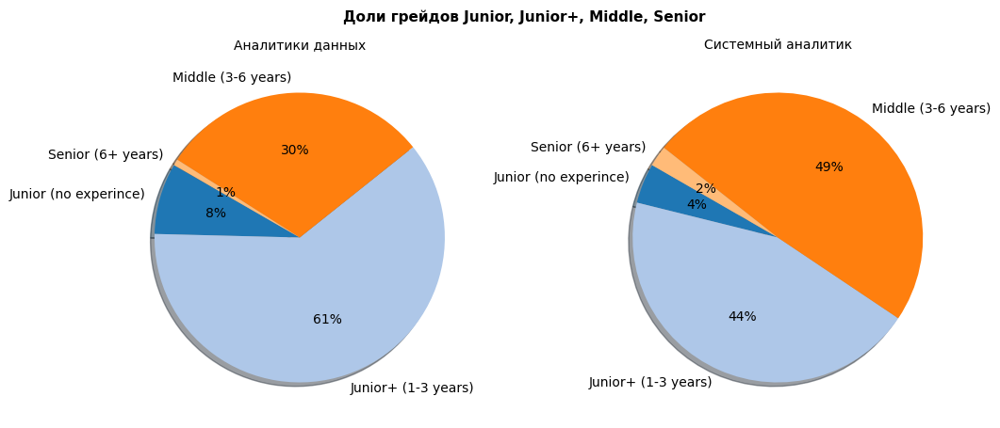

In [116]:
fig, ax = plt.subplots(1, 2, figsize=(12, 5))
# Сформируем поле для диаграмм


ax[0].pie(da,
          labels= [lbl for lbl, value in da.items()],
          shadow=True,
          startangle=150,
          autopct='%1.f%%',
          textprops={'fontsize': 10},
          colors=sns.color_palette('tab20'))
ax[0].set_title('Аналитики данных', fontsize=10, fontweight='normal')
# Построим круговую диаграмму по аналитикам данных

ax[1].pie(sa,
       labels= [lbl for lbl, value in sa.items()],
       shadow=True,
       startangle=150,
       autopct='%1.f%%',
       textprops={'fontsize': 10},
       colors=sns.color_palette('tab20'))
ax[1].set_title('Системный аналитик', fontsize=10, fontweight='normal')
# Построим круговую диаграмму для Системных аналитиков

plt.suptitle('Доли грейдов Junior, Junior+, Middle, Senior', fontsize=11, fontweight='bold')
plt.show()

Из распределения доли грейдов, у аналитиков данных и системных аналитиков видно, что основная масса вакансий это Junior+ и Middle, однако у системных аналитиков число вакансий с грейдом Middle примерно одинаковое с Junior+, 49%, 44% соответственно. Небольшое  количество вакансий для грейда Senior как у аналитиков данных, так и у системных аналитиков.

# **Типичное место работы для Аналитика данных и Системного аналитика**

**Найдем Топ-работодателей по числу вакансий**

In [117]:
def grade(df, indicator_, title_):

    fig, ax = plt.subplots(2, 4, figsize=(35, 10))

    plt.suptitle(title_ + ' для Junior, Junior+, Middle, Senior', fontsize=16, fontweight='bold')

    experience = ['Junior (no experince)',
                  'Junior+ (1-3 years)',
                  'Middle (3-6 years)',
                  'Senior (6+ years)']
# Создадим функцию которая будет выводить графики интересующих нас категорий в разрезе грейдов

    for i in range(len(experience)):
      da_skills = (
          df.loc[(df['vacansy_type'] == 'data_analityc') & (df['experience'] == f'{experience[i]}')
          , indicator_]
          .value_counts()).reset_index().head(10)
      sa_skills = (
          df.loc[(df['vacansy_type'] == 'sistem_analityc') & (df['experience'] == f'{experience[i]}')
          , indicator_]
          .value_counts()).reset_index().head(10)
# Построим графики с рейтингом скилов

      sns.barplot(x='count', y=indicator_, data=da_skills, ax=ax[0, i], color='yellow')
      ax[0, i].set_title(f"Аналитики {experience[i]}", fontsize=14)
      ax[0, i].set_xlabel('')
      ax[0, i].set_ylabel('')
# График для аналитиков данных



      sns.barplot(x='count', y=indicator_, data=sa_skills, ax=ax[1, i], color='green')
      ax[1, i].set_title(f"Системные аналитики {experience[i]}", fontsize=14)
      ax[1, i].set_xlabel('')
      ax[1, i].set_ylabel('')
      # График для Cистемных аналитиков

    plt.subplots_adjust(wspace = 0.8)
    plt.show()
# Сформируем поле для диаграмм

In [118]:
da=all_vacanсy.loc[all_vacanсy['vacansy_type']== 'data_analityc']['employer'].value_counts().reset_index().head(10)
sa=all_vacanсy.loc[all_vacanсy['vacansy_type']== 'sistem_analityc']['employer'].value_counts().reset_index().head(10)
 # top-10 работодателей по количеству вакансий

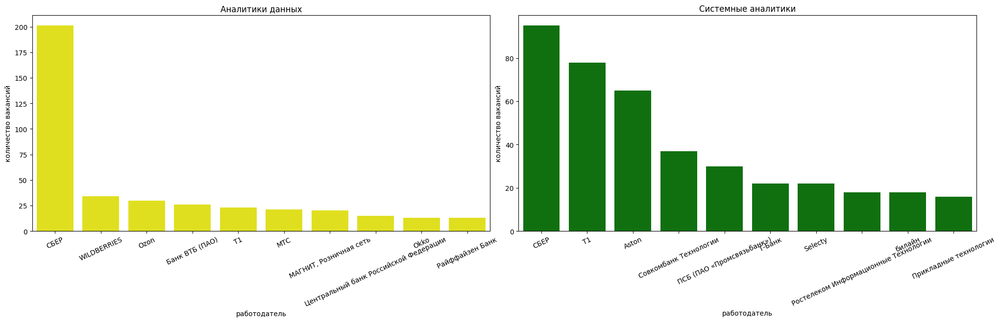

In [119]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
fig. tight_layout ()
# Сформируем поле для графиков

sns.barplot(x='employer', y='count', data=da, ax=ax[0], color='yellow')
ax[0].set_title("Аналитики данных")
ax[0].set_xlabel('работодатель')
ax[0].set_ylabel('количество вакансий')
ax[0].tick_params(axis='x', labelrotation=25)
# График для аналитиков данных

sns.barplot(x='employer', y='count', data=sa, ax=ax[1], color='green')
ax[1].set_title("Системные аналитики")
ax[1].set_xlabel('работодатель')
ax[1].set_ylabel('количество вакансий')
ax[1].tick_params(axis='x', labelrotation=25)
# График для системных аналитиков


plt.show()


Наибольшее число вакансий для Аналитиков данных предлагает СБЕР. Для Системных аналитиков выбор работодателей более шире, достаточно большое количество вакансий предлагает СБЕР, Т1, Aston, Совкомбанк Технологии, ПСБ(ПАо Промсвязьбанк)

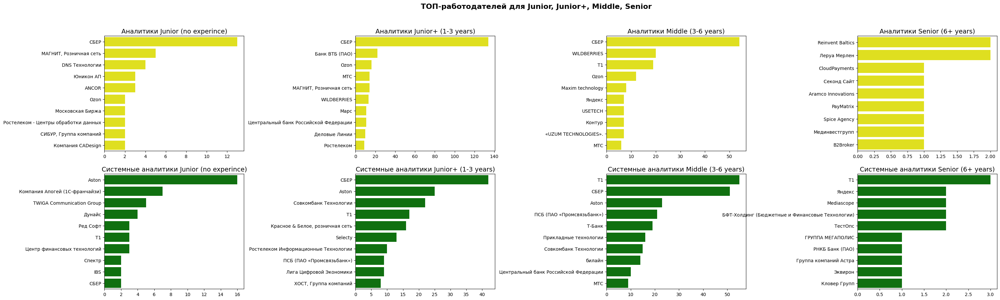

In [120]:
df = all_vacanсy
indicator_ = 'employer'
title_ = 'ТОП-работодателей'
grade(df, indicator_, title_)
# Графики топ-10 работодателей по грейдам

Лидером о количеству вакансий в разрезе всех грейдов является - СБЕР.

**Аналитиками данных интересуются:**

Без опыта -  МАГНИТ, РОзничная сеть, DNS Технологии, Юникон АП, ANСOR

С опытом работы 1-3 года - Банк ВТБ(ПАО), Ozon, МТС

С опытом работы 3-6 лет - Wildberries, T1, Ozon

С опытом работы более 6 лет - Rainvent Baltics, Леруа Мерлен(Лемана ПРО-новое наименование), CloudPayments, Секонд Сайд, Aramco innovations, PayMatrix, Spice gency, Мединвестгрупп, b2broker

**Системными Аналитиками интересуются:**

Без опыта - Aston, Компания Апогей(1С-Франчайзи), Twiga Communication group, Дунайс

С опытом работы 1-3 года - Aston, Совкомбанк Технологии, Т1, Красное&Белое, розничная сеть

С опытом работы 3-6 лет - Т1,СБЕР, Aston ПСБ(ПАО Промсвязьбанк), Т-Банк

С обытом работы более 6 лет - Т1, Яндекс, Mediascope, БФТ-Холдинг.

 **НАйдем типичную зарплату**

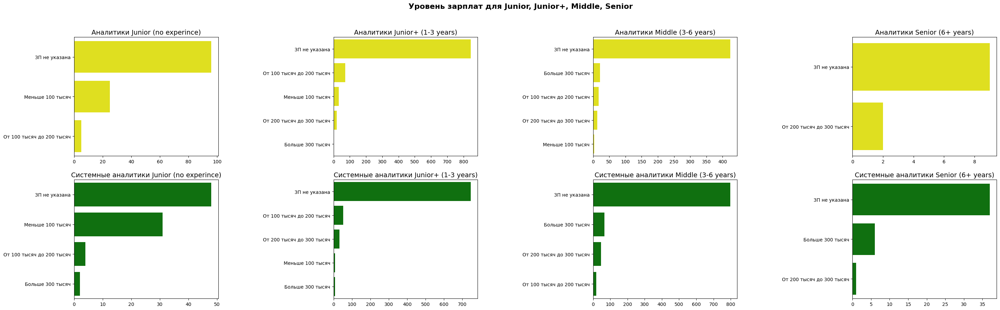

In [121]:
df = all_vacanсy
indicator_ = 'salary_bin'
title_ = 'Уровень зарплат'
grade(df, indicator_, title_)
# Графики уровня зарпат по грейдам

In [122]:
def calculate_avg_salary(row):
    '''Функция считает среднюю заработную плату на основании двух столбцов salary_from и salary_to'''

    # Извлекаем значения минимальной и максимальной заработной платы из строки
    min_salary = row['salary_from']
    max_salary = row['salary_to']

    # Если оба значения заработной платы отсутствуют, возвращаем NaN
    if pd.isna(min_salary) and pd.isna(max_salary):
        return np.nan
    # Если отсутствует минимальная заработная плата, возвращаем максимальную
    elif pd.isna(min_salary):
        return max_salary
    # Если отсутствует максимальная заработная плата, возвращаем минимальную
    elif pd.isna(max_salary):
        return min_salary
    # Если оба значения присутствуют, рассчитываем и возвращаем среднюю заработную плату
    else:
        return (min_salary + max_salary) / 2
all_vacanсy['avg_salary'] = all_vacanсy.apply(calculate_avg_salary, axis=1)


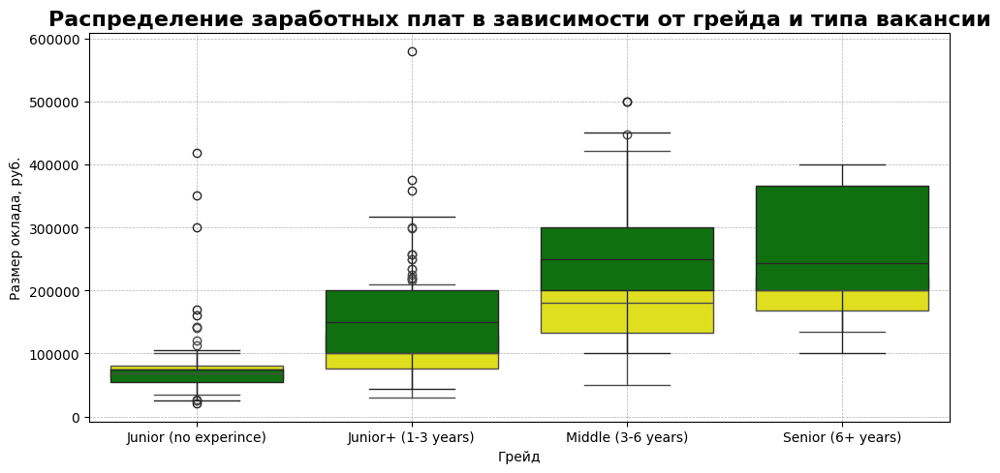

In [123]:
# Фильтрация данных для аналитика данных и системного аналитика
data_analytics = all_vacanсy[all_vacanсy['vacansy_type'] == 'data_analityc']
system_analytics = all_vacanсy[all_vacanсy['vacansy_type'] == 'sistem_analityc']

# Создание фигуры и указание ее размера
plt.figure(figsize=(10, 5))

# Построение boxplot для отображения распределения зарплат в зависимости от опыта
sns.boxplot(data=data_analytics, x="experience", y="avg_salary", color='yellow')
sns.boxplot(data=system_analytics, x="experience", y="avg_salary", color='green')

# Установка заголовка и меток осей
plt.title('Распределение заработных плат в зависимости от грейда и типа вакансии', fontsize=16, fontweight='bold')
plt.xlabel('Грейд')
plt.ylabel('Размер оклада, руб.')


# Добавление сетки на график
plt.grid(True, which='both', linestyle='--', linewidth=0.5)

# Обеспечение плотной компоновки элементов графика
plt.tight_layout()

# Отображение графика
plt.show()

Анализ указанного в вакансиях уровня оплаты труда показывает следующее:

Менее 100 тыс. рублей предлагается только специалистам уровня Junior и Junior+.

От 200 до 300 тыс. рублей - это типичный диапазон для соискателей уровня Middle.

Зарплата более 300 тыс. рублей встречается у Системных аналитиков.



**Установим желаемый график работы**

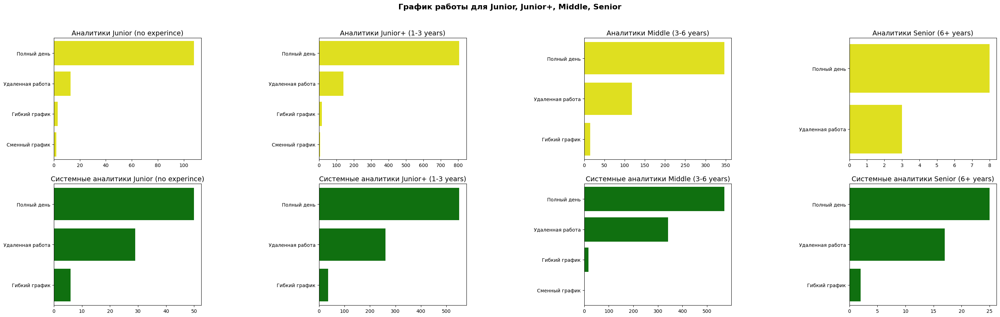

In [124]:
df = all_vacanсy
indicator_ = 'schedule'
title_ = 'График работы'
grade(df, indicator_, title_)

Во всех предлагаемых вакансиях требуются сотрудники на полный рабочий день,что говорит о том что работодатели хотят нанимать постоянных сотрудников, также предлагают удаленный формат работы.

**Определим требуемый тип занятости.**   

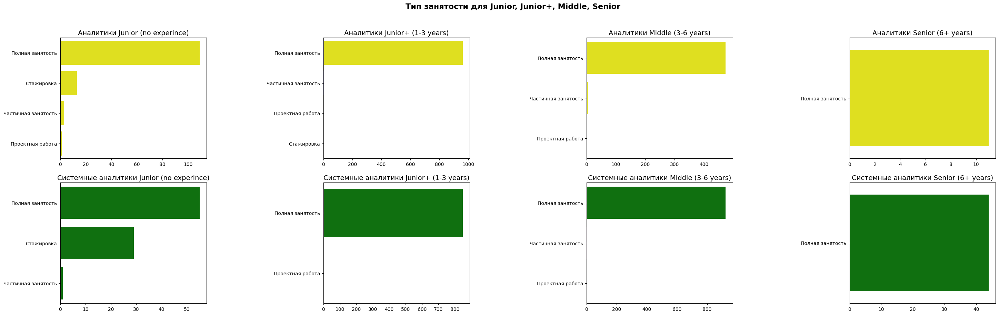

In [125]:
df = all_vacanсy
indicator_ = 'employment'
title_ = 'Тип занятости'
grade(df, indicator_, title_)

Все представленные вакансии рассичтаны на полную занятость, также для Junior аналииков данных и системных анаитиков предлагают стажировки, которые представляют собой программу обучения и практики, которая позволяет студентам или молодым специалистам получить опыт работы в области анализа данных или системного анализа. Во время стажировки участники могут изучать основные принципы и методы работы в соответствующей области, применять их на практике и развивать свои навыки под руководством опытных профессионалов.

**Установим какие навыки спрашивают чаще — "твердые' или 'мягкие", а также обозначим к какому грейду и к какой специальности требований больше.**

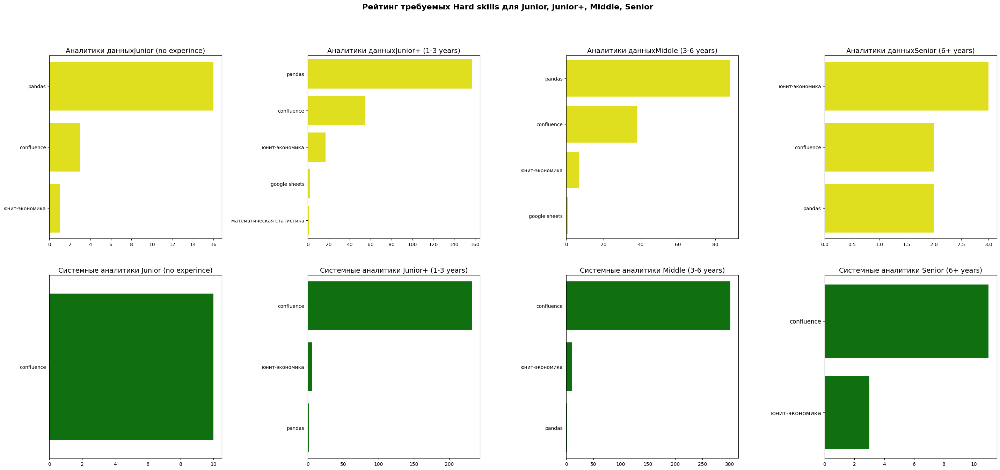

In [126]:

all_skills = all_vacanсy[['id',
                         'vacansy_type',
                         'experience',
                         'hard_skills_from_description'
                         ]].reset_index(drop=True)
# Подготовка и составление рейтинга востребованных Хард скилов


all_skills['hard_skills_from_description'] = all_skills['hard_skills_from_description'].str.split(',')
# преобразование перечня скилов в список

all_skills = all_skills.explode('hard_skills_from_description')
# Вывод кадого скила отдельной строкой

all_skills['hard_skills_from_description'] = (all_skills['hard_skills_from_description']
                                                 .str.lower().str.strip())
# приодим данные к нижнему регистру и убираем пробелы


fig, ax = plt.subplots(2, 4, figsize=(35, 15))
plt.suptitle('Рейтинг требуемых Hard skills для Junior, Junior+, Middle, Senior', fontsize=16, fontweight='bold')
# Поле для диаграмм

experience = ['Junior (no experince)',
              'Junior+ (1-3 years)',
              'Middle (3-6 years)',
              'Senior (6+ years)']

for i in range(len(experience)):
  da_skills = (
      all_skills.loc[(all_skills['vacansy_type'] == 'data_analityc') & (all_skills['experience'] == f'{experience[i]}')
      , 'hard_skills_from_description']
      .value_counts()).reset_index().head(10)
  sa_skills = (
      all_skills.loc[(all_skills['vacansy_type'] == 'sistem_analityc') & (all_skills['experience'] == f'{experience[i]}')
      , 'hard_skills_from_description']
      .value_counts()).reset_index().head(10)


  sns.barplot(x='count', y='hard_skills_from_description', data=da_skills, ax=ax[0, i], color='yellow')
  ax[0, i].set_title(f"Аналитики данных{experience[i]}", fontsize=14)
  ax[0, i].set_xlabel('')
  ax[0, i].set_ylabel('')
  # График для аналитиков данных

  sns.barplot(x='count', y='hard_skills_from_description', data=sa_skills, ax=ax[1, i], color='green')
  ax[1, i].set_title(f"Системные аналитики {experience[i]}", fontsize=14)
  ax[1, i].set_xlabel('')
  ax[1, i].set_ylabel('')
plt.yticks(fontsize=12)
plt.subplots_adjust(wspace = 0.5)
plt.show()


  # График для Системных аналитиков

Для аналитиков данных остовным "твердым" навыком которым нужно владеть, это Pandas, а так же Вики-система Confluence, которая предназначена для аналитиков данных и системных аналитиков для облегчения совместной работы и обмена знаниями в рабочей среде.

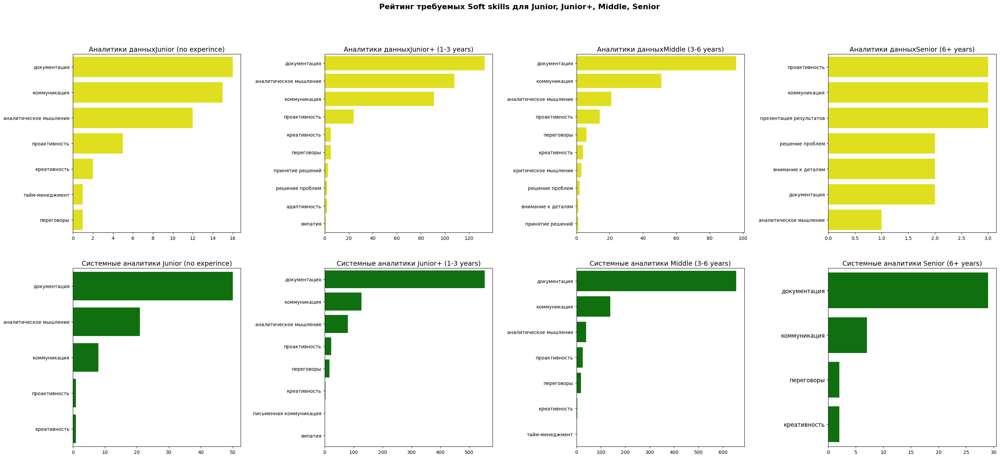

In [127]:

all_skills = all_vacanсy[['id',
                         'vacansy_type',
                         'experience',
                         'soft_skills_from_description'
                         ]].reset_index(drop=True)
# Подготовка и составление рейтинга востребованных Хард скилов


all_skills['soft_skills_from_description'] = all_skills['soft_skills_from_description'].str.split(',')
# преобразование перечня скилов в список

all_skills = all_skills.explode('soft_skills_from_description')
# Вывод кадого скила отдельной строкой

all_skills['soft_skills_from_description'] = (all_skills['soft_skills_from_description']
                                                 .str.lower().str.strip())
# приодим данные к нижнему регистру и убираем пробелы


fig, ax = plt.subplots(2, 4, figsize=(35, 15))
plt.suptitle('Рейтинг требуемых Soft skills для Junior, Junior+, Middle, Senior', fontsize=16, fontweight='bold')
# Поле для диаграмм

experience = ['Junior (no experince)',
              'Junior+ (1-3 years)',
              'Middle (3-6 years)',
              'Senior (6+ years)']

for i in range(len(experience)):
  da_skills = (
      all_skills.loc[(all_skills['vacansy_type'] == 'data_analityc') & (all_skills['experience'] == f'{experience[i]}')
      , 'soft_skills_from_description']
      .value_counts()).reset_index().head(10)
  sa_skills = (
      all_skills.loc[(all_skills['vacansy_type'] == 'sistem_analityc') & (all_skills['experience'] == f'{experience[i]}')
      , 'soft_skills_from_description']
      .value_counts()).reset_index().head(10)

  # График для аналитиков данных
  sns.barplot(x='count', y='soft_skills_from_description', data=da_skills, ax=ax[0, i], color='yellow')
  ax[0, i].set_title(f"Аналитики данных{experience[i]}", fontsize=14)
  ax[0, i].set_xlabel('')
  ax[0, i].set_ylabel('')



  sns.barplot(x='count', y='soft_skills_from_description', data=sa_skills, ax=ax[1, i], color='green')
  ax[1, i].set_title(f"Системные аналитики {experience[i]}", fontsize=14)
  ax[1, i].set_xlabel('')
  ax[1, i].set_ylabel('')
plt.yticks(fontsize=12)
plt.subplots_adjust(wspace = 0.5)
plt.show()

  # График для системных аналитиков

Для обеих специализаций наиболее востребованы умение читать и изучать, также составлять документацию и коммуникативность, аналитическое мышление. Также для аналитиков данных и системных аналитиков уровня Senor характерны такие навыки, как презентация результатов, переговоры, что может говорить о том, что данный уровень работодатель будет рассматривать, как руководителя.

**Выявим желаемых кандидатов на вакансии Аналитик данных и Системных аналиитков по следующим параметрам: самые важные hard-skils и soft-skils. Ответ отдельно дать для грейдов Junior, Junior+, Middle, Senior.**

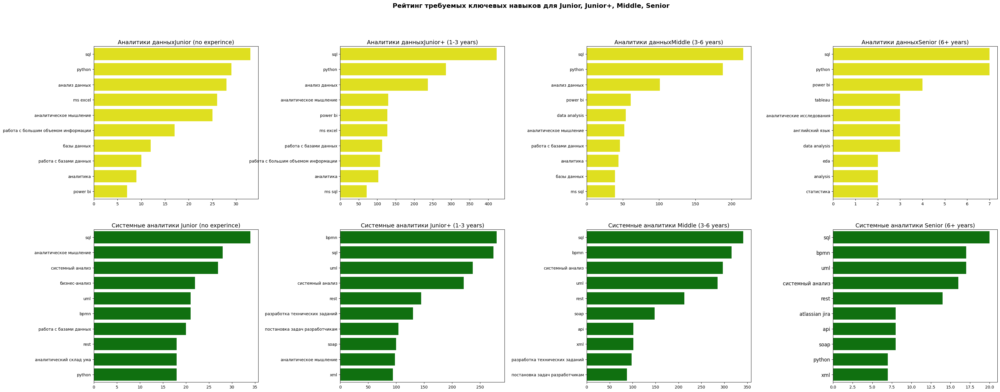

In [128]:

all_skills = all_vacanсy[['id',
                         'vacansy_type',
                         'experience',
                         'key_skills_from_key_skills_field'
                         ]].reset_index(drop=True)
# Подготовка и составление рейтинга востребованных Хард скилов


all_skills['key_skills_from_key_skills_field'] = all_skills['key_skills_from_key_skills_field'].str.split(',')
# преобразование перечня скилов в список

all_skills = all_skills.explode('key_skills_from_key_skills_field')
# Вывод кадого скила отдельной строкой

all_skills['key_skills_from_key_skills_field'] = (all_skills['key_skills_from_key_skills_field']
                                                 .str.lower().str.strip())
# приодим данные к нижнему регистру и убираем пробелы


fig, ax = plt.subplots(2, 4, figsize=(40, 15))
plt.suptitle('Рейтинг требуемых ключевых навыков для Junior, Junior+, Middle, Senior', fontsize=16, fontweight='bold')
# Поле для диаграмм

experience = ['Junior (no experince)',
              'Junior+ (1-3 years)',
              'Middle (3-6 years)',
              'Senior (6+ years)']

for i in range(len(experience)):
  da_skills = (
      all_skills.loc[(all_skills['vacansy_type'] == 'data_analityc') & (all_skills['experience'] == f'{experience[i]}')
      , 'key_skills_from_key_skills_field']
      .value_counts()).reset_index().head(10)
  sa_skills = (
      all_skills.loc[(all_skills['vacansy_type'] == 'sistem_analityc') & (all_skills['experience'] == f'{experience[i]}')
      , 'key_skills_from_key_skills_field']
      .value_counts()).reset_index().head(10)


  sns.barplot(x='count', y='key_skills_from_key_skills_field', data=da_skills, ax=ax[0, i], color='yellow')
  ax[0, i].set_title(f"Аналитики данных{experience[i]}", fontsize=14)
  ax[0, i].set_xlabel('')
  ax[0, i].set_ylabel('')

 # График для аналитиков данных

  sns.barplot(x='count', y='key_skills_from_key_skills_field', data=sa_skills, ax=ax[1, i], color='green')
  ax[1, i].set_title(f"Системные аналитики {experience[i]}", fontsize=14)
  ax[1, i].set_xlabel('')
  ax[1, i].set_ylabel('')
plt.yticks(fontsize=12)
plt.subplots_adjust(wspace = 0.5)
plt.show()
 # График для системных аналитиков


Рейтинг ключевых навыков соискателей, которые работодатель указывает в вакансиях, показывает, что для обеих профессий наиболее важными навыками являются владение языком программирования Python, языком запросов SQL и основами статистики. Это логично, так как основная деятельность в этих профессиях связана с извлечением, обработкой и анализом информации. Однако, есть некоторые отличия в требуемых навыках для аналитиков данных и системных аналитиков. Работодатели ожидают, что аналитики данных будут владеть Excel и инструментами построения дашбордов, такими как Tableau, Grafana и Power BI. Системным аналитикам же требуется владение системным анализом, UML и BPMN.

# **Расчет помесячной динамики количества вакансий Аналитик данных и Системный аналитик**

In [144]:
min_published_date_data_analityc = all_vacanсy[all_vacanсy['vacansy_type'] == 'data_analityc']['published_at'].min()
max_published_date_data_analityc = all_vacanсy[all_vacanсy['vacansy_type'] == 'data_analityc']['published_at'].max()

print('Первая публикация вакансии Аналитик данных:', min_published_date_data_analityc)
print('Последняя публикация вакансии Аналитик данных:', max_published_date_data_analityc)

Первая публикация вакансии Аналитик данных: 2024-02-13 21:45:51
Последняя публикация вакансии Аналитик данных: 2024-06-11 15:07:30


In [148]:
min_published_date_sistem_analityc = all_vacanсy[all_vacanсy['vacansy_type'] == 'sistem_analityc']['published_at'].min()
max_published_date_sistem_analityc = all_vacanсy[all_vacanсy['vacansy_type'] == 'sistem_analityc']['published_at'].max()

print('Первая публикация вакансии Системный аналитик:', min_published_date_sistem_analityc)
print('Последняя публикация вакансии Системный аналитик:', max_published_date_sistem_analityc)

Первая публикация вакансии Системный аналитик: 2024-06-27 06:08:10
Последняя публикация вакансии Системный аналитик: 2024-07-09 12:47:11


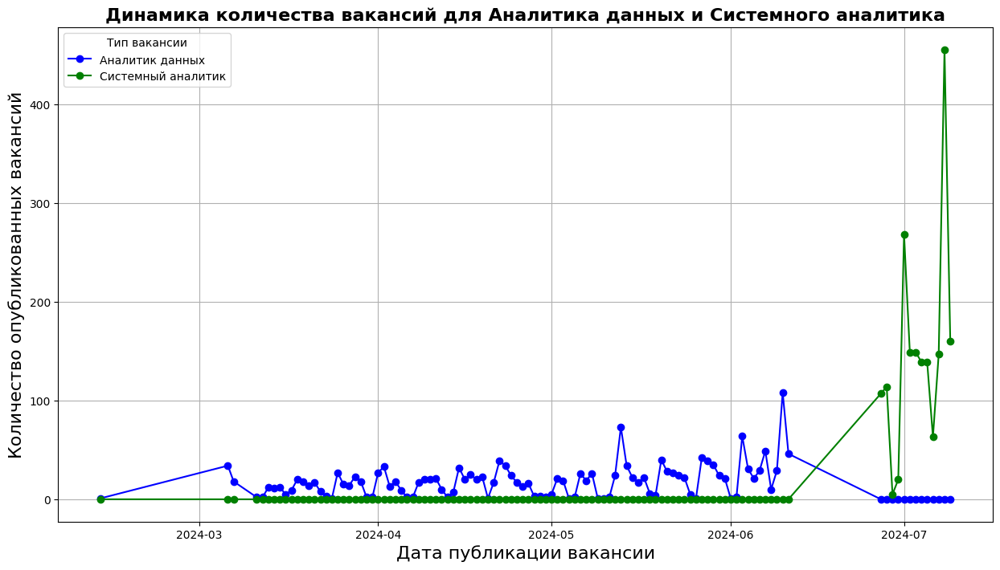

In [135]:
per_date = pd.concat([data_da, data_sa])


per_date = per_date[['id', 'vacansy_type', 'published_at']].sort_values(by='published_at')


per_date['published_at'] = per_date['published_at'].dt.date


per_date.pivot_table(index='published_at', columns='vacansy_type', values = 'id', aggfunc='count')\
.fillna(0)\
.plot(figsize=(15, 8), style='o-', grid=True, color=['blue', 'green'])

plt.title('Динамика количества вакансий для Аналитика данных и Системного аналитика',
          fontsize=16, fontweight='bold')
plt.xlabel('Дата публикации вакансии', fontsize=16)
plt.xticks(rotation=0)
plt.ylabel('Количество опубликованных вакансий', fontsize=16)
plt.legend(['Аналитик данных', 'Системный аналитик'], title='Тип вакансии', loc=2)
plt.show()

Динамика количества вакансий для Аналитика данных и Системных аналитиков показывает, что на протяжении  периода Аналитики данных требуются чаще, однако можно заметить, что число публикаций вакансий для Системных аналитиков гораздо выше.


#**ОБЩИЙ ВЫВОД**

При анализе вакансий для аналитиков данных и системных аналитиков были обнаружены следующие особенности:
Дублирующиеся вакансии: Встречаются вакансии с одинаковым идентификатором, но разными видами вакансий. Это означает, что эти публикации относятся как к вакансиям аналитиков данных, так и к вакансиям датасайентистов. Такие дубли не были удалены из выборки, так как они представляют существующие вакансии с различными требованиями, применимыми к обоим типам вакансий.

- Удаление дубликатов: Были удалены дублирующиеся публикации одной вакансии с разными идентификаторами и датами публикации, но идентичными данными в остальных полях. Это позволило избежать искажений в статистике.

- Важные навыки: Для обеих профессий (аналитик данных и системный аналитик) наиболее важными навыками являются владение языком программирования Python, языком запросов SQL и основами статистики. Дополнительно, аналитикам данных требуется владение Excel и инструментами построения дашбордов (например, Tableau, Grafana, Power BI), в то время как системным аналитикам необходимо знание системного анализа, UML и BPMN.

- Уникальные названия вакансий: В выборке присутствует 1574 уникальных названия вакансий. Некоторые из этих названий могут содержать дополнительную информацию, не относящуюся к самому названию.


**ТОП 10 работодаелей по количеству опубликованных вакансий**
СБЕР - 296

Т1 - 101

Aston - 66

WILDBERRIES - 42

ПСБ(ПАО Промсвязьбанк) - 38

Совкомбанк Технологии - 37

Ozon - 36

МТС - 35

Банк ВТБ (ПАО) - 31

Билайн 26
    

**ТОП 10 городов по количеству опубликованных вакансий**

Москва - 2212

Санкт-Петербург - 378

Екатеринбург - 106

Новосибирск - 81

Казань - 79

Нижний Новгород - 64

Краснодар - 49

Самара - 40

Владивосток - 38

Ростов-на-Дону - 33


**Распределение грейдов:**

на должность Аналитик данных и Системный аналитик наибольшее предпочтение отдается соискателям категории Junior+ с опытом от 1 до 3 лет и Middle с опытом от 3 до 6 лет

для обеих профессий примерно одинаковое количество вакансий для соискателей без опыта (4-8%), а также Senior (1-2%)

**Ключевые навыки:**

для обеих профессий наиболее важными навыками являются владение зыком программирования PYTHON и языком запросов SQL.

основные отличия в том, что от Аналитиков данных работодатели ожидают владения Excel и инструментами построения Дашбордов (Tableu, Power BI), а от Специалистов по Data Science владение bpmn, uml.

Для обоих профеcсий важно  умение читать и изучать, также составлять документацию и коммуникативность, аналитическое мышление.

**ТОП работодателей**

Бесспорным лидером вреди работодателей, является СБЕР, далее работодатели разбросаны следующим образом:

**Аналитиками данных интересуются:**

Без опыта -  МАГНИТ, РОзничная сеть, DNS Технологии, Юникон АП, ANСOR

С опытом работы 1-3 года - Банк ВТБ(ПАО), Ozon, МТС

С опытом работы 3-6 лет - Wildberries, T1, Ozon

С опытом работы более 6 лет - Rainvent Baltics, Леруа Мерлен(Лемана ПРО-новое наименование), CloudPayments, Секонд Сайд, Aramco innovations, PayMatrix, Spice gency, Мединвестгрупп, b2broker

**Системными Аналитиками интересуются:**

Без опыта - Aston, Компания Апогей(1С-Франчайзи), Twiga Communication group, Дунайс

С опытом работы 1-3 года - Aston, Совкомбанк Технологии, Т1, Красное&Белое, розничная сеть

С опытом работы 3-6 лет - Т1,СБЕР, Aston ПСБ(ПАО Промсвязьбанк), Т-Банк

С обытом работы более 6 лет - Т1, Яндекс, Mediascope, БФТ-Холдинг.

Лидером о количеству вакансий в разрезе всех грейдов является - СБЕР.

**Аналитиками данных интересуются:**

Без опыта -  МАГНИТ, РОзничная сеть, DNS Технологии, Юникон АП, ANСOR

С опытом работы 1-3 года - Банк ВТБ(ПАО), Ozon, МТС

С опытом работы 3-6 лет - Wildberries, T1, Ozon

С опытом работы более 6 лет - Rainvent Baltics, Леруа Мерлен(Лемана ПРО-новое наименование), CloudPayments, Секонд Сайд, Aramco innovations, PayMatrix, Spice gency, Мединвестгрупп, b2broker

**Системными Аналитиками интересуются:**

Без опыта - Aston, Компания Апогей(1С-Франчайзи), Twiga Communication group, Дунайс

С опытом работы 1-3 года - Aston, Совкомбанк Технологии, Т1, Красное&Белое, розничная сеть

С опытом работы 3-6 лет - Т1,СБЕР, Aston ПСБ(ПАО Промсвязьбанк), Т-Банк

С обытом работы более 6 лет - Т1, Яндекс, Mediascope, БФТ-Холдинг.

Анализ указанного в вакансиях уровня оплаты труда показывает что:

менее 100 тыс.руб. предлагается только специалистам уровня Junior и Junior+

от 200 до 300 тыс. руб - вилка характерна для соискателей уровня Middle

более 300 тыс. руб встречается у Специалистов по Data Science более 300 тыс. руб

Также необходимо отметить, что у большинства вакансий не указан диапазон зарплат.

Все представленные вакансии рассичтаны на полную занятость, также для Junior аналииков данных и системных анаитиков предлагают стажировки, которые представляют собой программу обучения и практики, которая позволяет студентам или молодым специалистам получить опыт работы в области анализа данных или системного анализа. Во время стажировки участники могут изучать основные принципы и методы работы в соответствующей области, применять их на практике и развивать свои навыки под руководством опытных профессионалов.

Динамика количества вакансий для Аналитика данных и Системных аналитиков показывает, что на протяжении  периода Аналитики данных требуются чаще, однако можно заметить, что число публикаций вакансий для Системных аналитиков гораздо выше.